# Agent-Based Model for Fractional Brownian Motion

In [1]:
import agentpy as ap
import numpy as np, pandas as pd, matplotlib.pyplot as plt
from IPython.display import HTML
import IPython
import matplotlib.animation as animation
from stochastic.processes.continuous import FractionalBrownianMotion, BrownianMotion

## Define Agents

In [2]:
class Base_Agent(ap.Agent):
    
    def setup(self):
        fbm = FractionalBrownianMotion(t=(self.p.steps*self.p.fps), hurst=self.p.hurst)
        x_sample = fbm.sample((self.p.steps*self.p.fps)+1) #Create list of samples
        y_sample = fbm.sample((self.p.steps*self.p.fps)+1)
        z_sample = fbm.sample((self.p.steps*self.p.fps)+1)
        self.x,self.y,self.z= [],[],[]
        for i in range (self.p.steps): #Create list of steps (difference between 2 samples). We can't use move_to because negative co-ordinates aren't accepted
            self.x.append( x_sample[i+1]-x_sample[i])
            self.y.append( y_sample[i+1]-y_sample[i])
            self.z.append( z_sample[i+1]-z_sample[i])

        #Do the same for a higher hurst exponent to sample from when the collision condition is activiated to simulate CIL
        self.fbm2 = FractionalBrownianMotion(t=(self.p.steps * self.p.fps), hurst=self.p.CIL_hurst)
        self.x_sample2 = self.fbm2.sample((self.p.steps * self.p.fps) + 1)
        self.y_sample2 = self.fbm2.sample((self.p.steps * self.p.fps) + 1)
        self.z_sample2 = self.fbm2.sample((self.p.steps * self.p.fps) + 1)
        self.x2, self.y2, self.z2 = [], [], []
        for i in range(self.p.steps):
            self.x2.append(self.x_sample2[i + 1] - self.x_sample2[i])
            self.y2.append(self.y_sample2[i + 1] - self.y_sample2[i])
            self.z2.append(self.z_sample2[i + 1] - self.z_sample2[i])
        
        self.CILrand = np.random.uniform(0,(self.p.steps-10))
    
    def setup_space(self, space):
        self.space = space
        self.in_contact = 0 #0 for not in contact and 1 for in contact
        self.stp_num = 0 #each agent carries the step number so they know which position to move to
        self.neighbors = space.neighbors
        self.pos = space.positions[self]
        self.hit = 0
        self.h_count = 0
        self.CILrand = 0
        
    def update_stp_num(self):
        self.stp_num += 1
        self.space.record_positions(label='dimension') #record position after each sept to enable calculations, having it here makes it belong to the agent, not the model
        if self.hit == 1 and self.h_count == 0: #At the position where the hit occurs, record the collision
            self.record('Collision position', 'True')
        else:
            self.record('Collision position', 'False')
          
    def border_check(self): #Reflect off border
       #For each of the 3 dimensions
        if self.pos[0] >= self.p.size_x -1 : #Maximum edge
            self.x[self.stp_num*self.p.fps:(self.stp_num+10)*self.p.fps] = -1
        elif self.pos[0] <= 1: #Minimum edge
            self.x[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] = self.x[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] * -1
            
        if self.pos[1] >= self.p.size_y - 1: #Maximum edge
            self.y[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] = self.y[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] * -1
        elif self.pos[1] <= 1: #Minimum edge
            self.y[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] = self.y[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] * -1

        if self.pos[2] >= self.p.size_z - 1: #Mazimum edge
            self.z[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] = self.z[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] * -1
        elif self.pos[2] <= 1: #Minimum edge
            self.z[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] = self.z[self.stp_num*self.p.fps:(self.stp_num+100)*self.p.fps] * -1 

In [3]:

class MyAgent(Base_Agent):
    
    
    def update_position(self):
        temp = np.array([])
        temp = np.append(temp, self.x[self.stp_num] )
        temp = np.append(temp, self.y[self.stp_num] )
        temp = np.append(temp, self.z[self.stp_num] )
        #self.border_check()
        self.space.move_by(self, temp)




    def update_position_with_collisions(self): #collision = CIL in this case
        temp = np.array([])
        if self.hit == 0:
            temp = np.append(temp, self.x[self.stp_num])
            temp = np.append(temp, self.y[self.stp_num])
            temp = np.append(temp, self.z[self.stp_num])


        #CILRAND means the same sequence isnt chosen each time CIL is activated
        if self.hit == 1:  # change Hurst exponent for 10 steps
            ib = self.h_count
            temp = np.append(temp, self.x2[ib + int(self.CILrand)] )
            temp = np.append(temp, self.y2[ib + int(self.CILrand)])
            temp = np.append(temp, self.z2[ib + int(self.CILrand)])
            self.h_count += 1
            if self.h_count == self.p.elevated_H_duration: #10 steps is arbitrary
                self.h_count = 0
                self.hit = 0
                self.CILrand = np.random.uniform(0,(self.p.steps-10))

        # self.border_check()
        self.space.move_by(self, temp)

        if len(self.neighbors(self, distance=parameters.get('collision_distance'))) >= 1:
            # reflect the original agent's path causing the collision:
            self.collision_position = self.pos  # record position of collision for the heat map
            self.hit = 1
            for neighbour in self.neighbors(self, distance=1):
                # there is a collision
                neighbour.hit = 1


## Define Model

In [4]:
# Create an empty list to store arrays
positions_list = []

# Loop 100 times and append an array of floats to the list
for i in range(100): # or whatever population is
    positions_list.append(np.array([50.0, 50.0, np.random.uniform(0,100)], dtype=float))

# Convert the list to a NumPy array
midline_positions = np.array(positions_list)



In [5]:


class MyModel(ap.Model):
    
    def setup(self):
        self.space = ap.Space(self, shape=[self.p.size_x]+[self.p.size_y]+[self.p.size_z], torus=False)
        self.agents = ap.AgentList(self, self.p.population, MyAgent)
        self.space.add_agents(self.agents, positions=positions_list)
        self.agents.setup_space(self.space)
        
        
    def step(self):
        if self.p.collisions== 'on':#take collisions into account
            
            counter = 0
            while counter < self.p.fps:
                self.agents.update_position_with_collisions()
                counter+=1
        else:
            self.agents.update_position()
        self.agents.update_stp_num()                                                                                                                                                                  

## Parameters

In [6]:

parameters = {
    'hurst': 0.5,
    'CIL_hurst': 0.75,
    'size_x': 100,
    'size_y': 100,
    'size_z': 100,
    'steps': 200, 
    'population': 100,
    'collisions': 'on',
    'fps': 1, #changing this still gives TMSD agreeing with results
    'collision_distance': 1 
    'elevated_H_duration': 10 
}

## Run Experiment

In [7]:
model = MyModel(parameters)
results = model.run()

#results.variables.MyModel.head() 
Agent_Variable_List = results.variables.MyAgent

Completed: 200 steps
Run time: 0:00:09.083092
Simulation finished


## Analysis

### Calculate TMSD

#### Prepare Data for TMSD calculation

In [8]:
sx,sy,sz =[],[],[]
sx.extend( Agent_Variable_List['dimension0'])
sx = np.array(sx)
chunked_arrays = np.array_split(sx, parameters.get('population')) #Split the list into as many lists as there are particles. seperates out x data for each particle
sx = [list(array) for array in chunked_arrays]
#Do the same for y values:
sy.extend( Agent_Variable_List['dimension1'])
sy = np.array(sy)
chunked_arrays = np.array_split(sy, parameters.get('population')) 
sy = [list(array) for array in chunked_arrays]
sz.extend( Agent_Variable_List['dimension2'])
sz = np.array(sz)
chunked_arrays = np.array_split(sz, parameters.get('population')) #Split the list into as many lists as there are particles. seperates out x data for each particle
sz = [list(array) for array in chunked_arrays]

In [9]:


data = {
    'Position X': np.concatenate(sx),
    'Position Y': np.concatenate(sy),
    'Position Z': np.concatenate(sz),
    'Time': np.tile(np.arange(len(sx[0])), parameters.get('population')),
    'TrackID': np.repeat(np.arange(parameters.get('population')), len(sx[0]))
    
}

df = pd.DataFrame(data)


In [10]:

# Export to CSV
df.to_csv('D:/ABM24_H05_75_2.csv', index=False)


In [11]:
def Calculate_TMSD (time_lag, number_of_particles):
    tmsd = [] 
    for j in range (number_of_particles): #for each walk
        msd_r, msd_diff_sq, msd_r_timelag, msd_diff_sq_x, msd_diff_sq_y, msd_diff_sq_z = [],[],[],[],[],[] #create a list of lists for: all r values at each step, and squared differences, and r values with timelag
        x,y,z,r = [],[],[],[]
        x.extend((sx[j][::time_lag])) # Using extend instead of append creates a list with each element it's own, not inserting the whole list into element [0] of msd_r_timelag
        y.extend((sy[j][::time_lag]))
        z.extend((sz[j][::time_lag]))
        
        for i in range (len(x)-1): #difference has length of number of steps -1 so this avoids "out of range erros"
            msd_diff_sq_x.append((x[i+1] - x[i])**2) #create a list of the square displacement for each particle for each step
            msd_diff_sq_y.append((y[i+1] - y[i])**2)
            msd_diff_sq_z.append((z[i+1] - z[i])**2)
            msd_diff_sq.append(msd_diff_sq_x[i] + msd_diff_sq_y[i] + msd_diff_sq_z[i]) #Calculate each one and add themtogether (see theory)

        tmsd.append(sum(msd_diff_sq)/len(msd_diff_sq)) #Add the TMSD for each walk to the list 
        
    tmsd = sum(tmsd)/len(tmsd) #average the TMSDs 
    del(msd_r, msd_diff_sq, msd_r_timelag,x,y,z,r,i,j) #clear from memory
    return tmsd

In [12]:
Calculate_TMSD(time_lag=1, number_of_particles=parameters.get('population'))

2.9293589865346257

[0, 2.9293589865346257, 5.993899454873188, 9.2158539384874, 12.499477058615478, 15.608130379253502, 18.952241827799433, 22.30161844423468, 25.735520752961477, 29.54459555315478, 32.495669527096986, 35.91576964370474, 39.664914038348755, 42.91022516205834, 45.36023564352876, 48.49906327086757, 52.80204178711596, 56.73584975108851, 60.23934245029036, 62.72212338046642]


<function matplotlib.pyplot.show(close=None, block=None)>

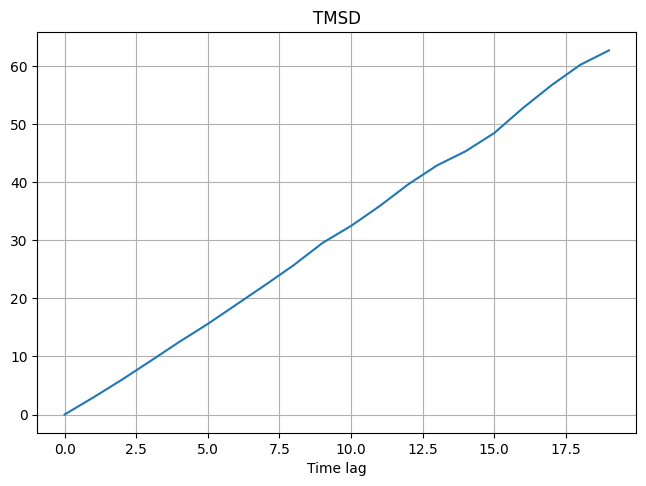

In [13]:
tmsd_variable_timelag =[0]
for k in range (1, 20):
    tmsd = [] 
    for j in range (parameters.get('population')): #for each walk
        msd_r, msd_diff_sq, msd_r_timelag, msd_diff_sq_x, msd_diff_sq_y, msd_diff_sq_z = [],[],[],[],[],[] #create a list of lists for: all r values at each step, and squared differences, and r values with timelag
        x,y,z,r = [],[],[],[]
        x.extend((sx[j][::k])) # Using extend instead of append creates a list with each element it's own, not inserting the whole list into element [0] of msd_r_timelag
        y.extend((sy[j][::k]))
        z.extend((sz[j][::k]))

        for i in range (len(x)-1): #difference has length of number of steps -1 so this avoids "out of range erros"
            msd_diff_sq_x.append((x[i+1] - x[i])**2) #create a list of the square displacement for each particle for each step
            msd_diff_sq_y.append((y[i+1] - y[i])**2)
            msd_diff_sq_z.append((z[i+1] - z[i])**2)
            msd_diff_sq.append(msd_diff_sq_x[i] + msd_diff_sq_y[i] + msd_diff_sq_z[i]) #Calculate each one and add themtogether (see theory)

        tmsd.append(sum(msd_diff_sq)/len(msd_diff_sq)) #Add the TMSD for each walk to the list 
        
    tmsd = sum(tmsd)/len(tmsd) #average the TMSDs 
    tmsd_variable_timelag.append(tmsd)
    del(msd_r, msd_diff_sq, msd_r_timelag, tmsd,x,y,z,r,i,j,k) #clear from memory
print (tmsd_variable_timelag)

fig, axs = plt.subplots(1)
#sanity check the results for first particle
axs.plot(tmsd_variable_timelag)
axs.set_title('TMSD')
plt.grid('True')
plt.xlabel  ('Time lag')
#x = np.linspace(0,20,100)
#y = x
#plt.plot(x, y, '-r', label='y=2x+1')
fig.tight_layout(pad=0.5, h_pad=None, w_pad=None, rect=None)
plt.draw

plt.show # keep at bottom, once per run of program

In [14]:
#proving there are collisions taking place
print(Agent_Variable_List) 

            dimension0  dimension1  dimension2 Collision position
obj_id t                                                         
2      1     50.543501   50.236535   51.686546               True
       2     50.569044   50.235240   51.773254              False
       3     49.769114   49.907938   52.248030              False
       4     50.544395   49.819845   52.122852              False
       5     51.529891   48.544257   49.824387              False
...                ...         ...         ...                ...
101    196   59.853006   55.155134    0.000000              False
       197   59.675076   54.627374    0.222218              False
       198   58.157868   54.065321    0.000000              False
       199   58.548871   53.671399    1.235059              False
       200   59.095676   52.775761    0.541638              False

[20000 rows x 4 columns]


#### Walk path of single particle

<function matplotlib.pyplot.show(close=None, block=None)>

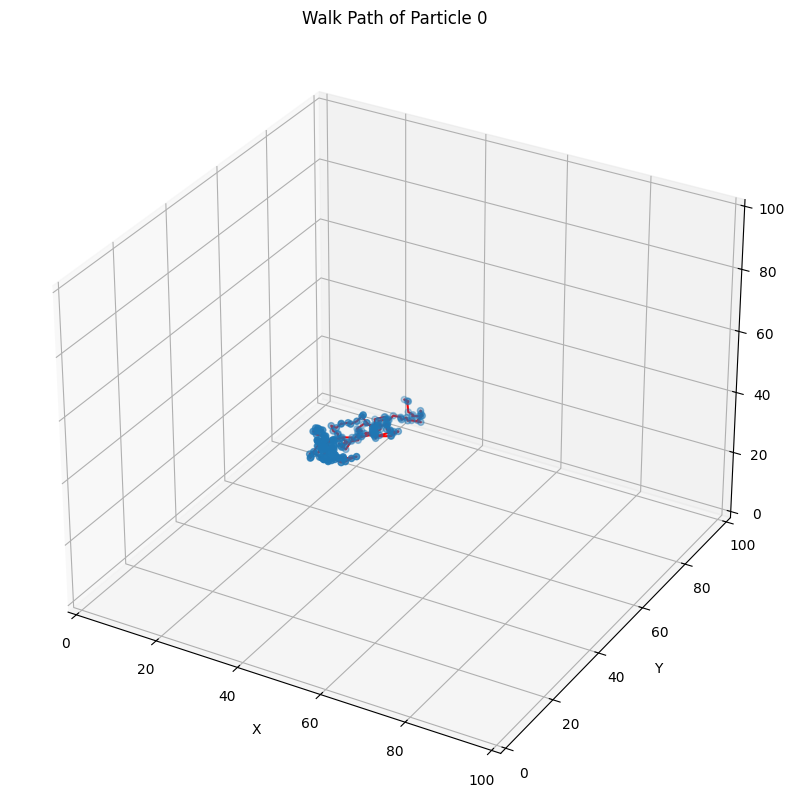

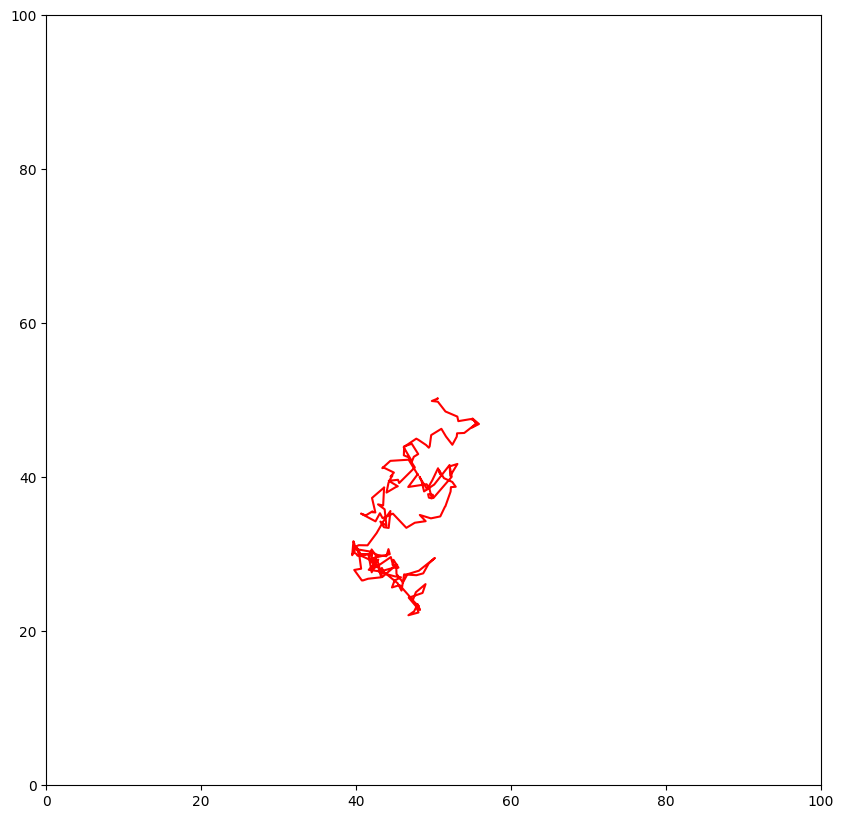

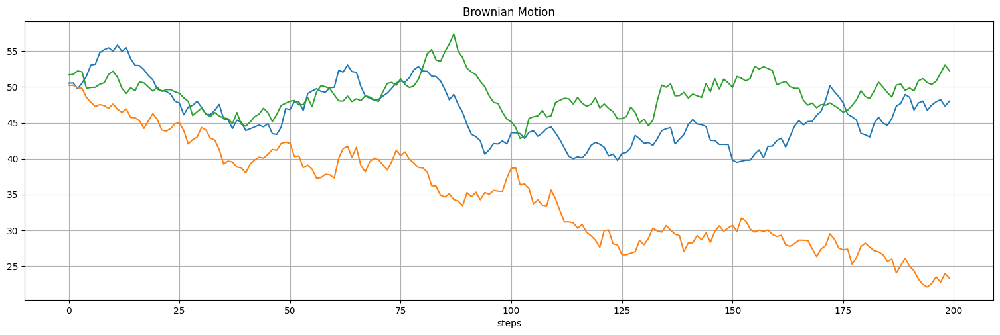

In [15]:
fig = plt.figure(figsize=(10,10)) #Reducing this makes it animate faster
ax3 = plt.axes(projection="3d")
plt.title('Walk Path of Particle 0')
plt.xlabel('X')
plt.ylabel('Y')
ax3.plot3D(sx[0],sy[0],sz[0], 'red') # plotting a 3D line graph with X-coordinate, Y-coordinate and Z-coordinate respectively
ax3.scatter3D(sx[0],sy[0],sz[0]) # plotting a scatter plot
ax3.set_xlim(0, parameters.get('size_x'))
ax3.set_ylim(0, parameters.get('size_y'))
ax3.set_zlim(0, parameters.get('size_z'))

#Walk path of one particle
fig4, ax4 = plt.subplots(1, figsize=(10,10))
ax4.plot(sx[0],sy[0],'red') # plotting a 2D line graph with X-coordinate, Y-coordinate and Z-coordinate respectively
ax4.set_xlim(0, parameters.get('size_x'))
ax4.set_ylim(0, parameters.get('size_y'))


fig2, axs2 = plt.subplots(1,figsize=(15,5))
#sanity check the results for first particle
axs2.plot(sx[0])
axs2.plot(sy[0])
axs2.plot(sz[0])
axs2.set_title('Brownian Motion')
plt.grid('True')
plt.xlabel  ('steps')
fig2.tight_layout(pad=0.5, h_pad=None, w_pad=None, rect=None)

plt.draw

plt.show

### Animate Results

MovieWriter imagemagick unavailable; using Pillow instead.
Animation size has reached 21086371 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


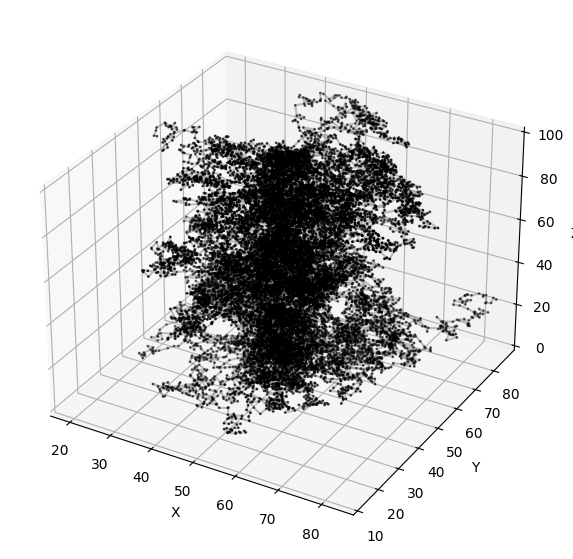

In [16]:


def update(frame, df, sc, trails):
    time_df = df[df['Time'] <= frame]
    sc._offsets3d = (time_df['Position X'], time_df['Position Y'], time_df['Position Z'])
    
    for i in range(df['TrackID'].nunique()):
        track = df[df['TrackID'] == i]
        trails[i].set_data(track['Position X'][:frame + 1], track['Position Y'][:frame + 1])
        trails[i].set_3d_properties(track['Position Z'][:frame + 1])

    return sc, *trails

def animation_plot(df, filename='animation.gif'):
    projection = '3d'
    fig = plt.figure(figsize=(7, 7))
    ax = fig.add_subplot(111, projection=projection)
    
    sc = ax.scatter([], [], [], s=1, c='black')
    
    trails = [ax.plot([], [], [], color='gray', alpha=0.5)[0] for _ in range(df['TrackID'].nunique())]

    ax.set_xlim(df['Position X'].min(), df['Position X'].max())
    ax.set_ylim(df['Position Y'].min(), df['Position Y'].max())
    ax.set_zlim(df['Position Z'].min(), df['Position Z'].max())
    
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    
    max_time = df['Time'].max()
    
    ani = animation.FuncAnimation(fig, update, frames=range(max_time + 1), fargs=(df, sc, trails), interval=100, repeat=False)
    
    ani.save(filename, writer='imagemagick')  # Requires ImageMagick for saving as GIF
    return HTML(ani.to_jshtml(fps=10))

# Call the function with your DataFrame
animation_plot(df, filename='ABM animation.gif')
